# Analysis of Income in the United States East Coast
Annie Lu  
CMSC320  
Final Tutorial Project

Published December 15th, 2018  

*Update: Maps only work well with Safari.*

### Introduction
Despite being a developed country, the United States has [considerable amount of income inequality](https://www.theatlantic.com/business/archive/2017/01/wef-davos-inequality/513185/). As an American issue, I want to explore (1) where income inequality resides using maps and (2) the various factors which could affect income. Since the dataset is large, I will look at this at regional level, the East Coast, rather than a national level. Specifically, nearby DC, Maryland, Virginia, Pennsylvania, Delaware, and New Jersey. Another objective of this tutorial is to try understanding the American Community Survey (ACS), because it seems to be a reliable, applicable source for U.S populations.

### Required Tools

Quite a few libraries are used in this tutorial. Some fundamentals for data science are [pandas](http://www.gregreda.com/2013/10/26/intro-to-pandas-data-structures/) and [numpy](https://engineering.ucsb.edu/~shell/che210d/numpy.pdf). Pandas provides flexible data structures, series and dataframes, along with useful functions to manipulate them. 
Numpy is a powerful mathematical library with an n dimensional array object, which performs fast calculations since it is based in C.

In [1]:
import pandas as pd
import numpy as np

Libraries for Data Collection:

In [2]:
from bs4 import BeautifulSoup
import requests

Libraries for Data Analysis and Data Visualization:

In [3]:
import matplotlib.pyplot as plt
import sklearn
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
import seaborn as sns
import folium
import branca

I'll also be using a tool called [IPUMS](https://usa.ipums.org/usa-action/faq) which helps create a dataset of selected variables from one or multiple samples, such as the American Community Survey (ACS).

### Data Collection

In this phase of the data life cycle, we collect data from both websites and files. A common file format is csv, which can be easily read with Pandas read_csv function. For websites, we use requests for the html, and properly parse it with the [Beautiful Soup Library](https://www.crummy.com/software/BeautifulSoup/bs4/doc/). To form a proper dataframe, we first prettify() and then use Pandas [read_html]( https://pandas.pydata.org/pandas-docs/stable/generated/pandas.read_html.html) function.

#### 1) Map/Geography

My data analysis/visualizations will, later on, rely on maps. Thus, it is necessary to collect geographical and location data. For a proper map with boundaries, I searched for json files which plotted either state or county boundaries by points. However, it was not enough to simply contain the boundaries; there also needed to be feature identification or properties, like state abbreviations and FIPS. The json files I ended up finding for the map, required corresponding state abbreviations and FIPS.

Some datasets did not have postal codes or FIPS, so I found a table online with both and parsed it using Beautiful Soup library.

In [4]:
r = requests.get("https://www.nrcs.usda.gov/wps/portal/nrcs/detail/?cid=nrcs143_013696")
state_code = BeautifulSoup(r.text, "html.parser")

state_code = state_code.find(id="detail") 
state_code = state_code.prettify() #readable html table format

state_code = pd.read_html(state_code) #returns list of dataframes with only [0] index
state_code = state_code[0]
state_code.columns=state_code.loc[0]
state_code=state_code.drop(0,0)
state_code.head()

,Name,Postal Code,FIPS
1,Alabama,AL,01
2,Alaska,AK,02
3,Arizona,AZ,04
4,Arkansas,AR,05
5,California,CA,06


Finding population was necessary to understand why some counties were covered and not others. Most often, counties that were densely populated/largest would have identified FIPS. 

In [5]:
county_population = pd.read_csv("county_population.csv", sep=',')

county_population=county_population[['STATE','COUNTY','STNAME','CTYNAME','POPESTIMATE2017']]

IDFIP =  []
PERCENTAGE = []
for index,row in county_population.iterrows():
    if(row['COUNTY']==0):
        total_pop=row['POPESTIMATE2017']
        PERCENTAGE.append(1)
    else:
        PERCENTAGE.append(row['POPESTIMATE2017']/total_pop)
    fip=""
    if(len(str(row['STATE']))==1):
        fip+=str(0)
    fip+=str(row['STATE'])
    if(len(str(row['COUNTY']))==2):
        fip+=str(0)
    else:
        if(len(str(row['COUNTY']))==1):
            fip+=str(0)+str(0)

    fip+=str(row['COUNTY'])
    IDFIP.append(fip)
      
county_population['IDFIP']=IDFIP
county_population['PERCENTAGE']=PERCENTAGE


county_population.head()

,STATE,COUNTY,STNAME,CTYNAME,POPESTIMATE2017,IDFIP,PERCENTAGE
0,1,0,Alabama,Alabama,4874747,01000,1.000000
1,1,1,Alabama,Autauga County,55504,01001,0.011386
2,1,3,Alabama,Baldwin County,212628,01003,0.043618
3,1,5,Alabama,Barbour County,25270,01005,0.005184
4,1,7,Alabama,Bibb County,22668,01007,0.004650


#### 2) USA Population data

To analyze income, we need data about the USA people and households. A staple dataset for this is the American Community Survey. A brief overview of the American Community Survey: this survey from the U.S Census Bureau collects data from American households on a monthly basis. There are a lot of variables which are recorded, including race, gender, age, income, household, etc. 

There are [various ways](https://www.census.gov/programs-surveys/acs/data.html) [to collect ACS data](https://trendct.org/2015/08/14/tutorial-how-to-understand-and-retrieve-census-data-for-beginners/), ranging in difficulty and flexibility. In general, from least to most difficulty/flexibility are the following: Census Reporter, American FactFinder, and IPUMS. In this tutorial, I will be using IPUMS.
This tool allows us to custom select variables and samples ahead of downloading the file. The file can be formatted multiple ways, but I chose csv or "comma separated values". 

The dataset has a massive amount of rows, yet still only covers 1% of the population. In general, for large groups like the entire US and states, this should be fine for drawing conclusions. The margin of error is somewhat insignificant at large levels. To prevent my computer from crashing and burning, I took a subset of this dataset, and focused on a state/regional level.

Throughout the data science life cycle is a lot of selecting. Pandas .loc and .iloc do a good job job with selecting elements and rows. Below I use loc with a boolean statement for selecting rows that matter. In this case, the rows I am selecting are people/households that reside within a certain state. This [site](https://www.ritchieng.com/pandas-selecting-multiple-rows-and-columns/) has some further examples to look over.

In [6]:
us=pd.read_csv("usa_00006.csv", sep=',')
maryland=us.loc[us['STATEFIP'] == 24]
dc=us.loc[us['STATEFIP'] == 11]
virginia=us.loc[us['STATEFIP'] == 51]
penn=us.loc[us['STATEFIP'] == 42]
delaware=us.loc[us['STATEFIP'] == 10]
jersey=us.loc[us['STATEFIP'] == 34]

data=pd.DataFrame()
data=data.append(maryland)
data=data.append(dc)
data=data.append(virginia)
data=data.append(penn)
data=data.append(delaware)
data=data.append(jersey)
data.head()

,YEAR,DATANUM,SERIAL,CBSERIAL,HHWT,STATEFIP,COUNTYFIPS,GQ,PERNUM,PERWT,...,RACWHT,EDUC,EDUCD,INCTOT,FTOTINC,INCWAGE,INCWELFR,POVERTY,MIGRATE1,MIGRATE1D
1325480,2017,1,573479,2017000000096,63,24,27,1,1,63,...,2,11,114,104000,138000,40000,0,501,1,10
1325481,2017,1,573479,2017000000096,63,24,27,1,2,65,...,2,11,114,34000,138000,5000,0,501,1,10
1325482,2017,1,573480,2017000000113,129,24,5,1,1,129,...,2,11,114,65000,119000,65000,0,398,1,10
1325483,2017,1,573480,2017000000113,129,24,5,1,2,134,...,2,7,71,30000,119000,30000,0,398,1,10
1325484,2017,1,573480,2017000000113,129,24,5,1,3,100,...,2,4,40,0,119000,0,0,398,1,10


Before processing the columns and rows to best suit the analysis, we must understand the variables. The description is pretty accessible on the [IPUMS USA website](https://usa.ipums.org/usa-action/variables/group). Below are the variables I selected, and a brief description of a few:
- 'YEAR' : every column value will be 2017, since this is from only the 2017 ACS Sample
- 'DATANUM' : ACS Data is often split into multiple parts simply for storage purposes, provides no further insight
- 'SERIAL' 'CBSERIAL' : Each household assigned a number distinct from all other households
- 'HHWT' 'PERWT' : The weight in which each household/person represents population
- 'STATEFIPS' 'COUNTYFIPS' : State and County number codes useful for maps
- 'SEX' : Male or Female
- 'RACE' : Gives a number, assigned as the following, 1	White, 2	Black/African American/Negro, 3	American Indian or Alaska Native, 4	Chinese, 5 Japanese, 6 Other Asian / Pacific Islander, 7 Other, 8 9 Mixed
- 'AGE' : Age
- 'EDUC', 'EDUCD' : Educational Attainment
- 'INCTOT' 'INCWAGE' 'INCWELFR': Various measures of personal income
- 'FTOTINC' : Household Income


In [28]:
list(data)

['YEAR',
 'DATANUM',
 'SERIAL',
 'CBSERIAL',
 'HHWT',
 'STATEFIP',
 'COUNTYFIPS',
 'GQ',
 'PERNUM',
 'PERWT',
 'SEX',
 'AGE',
 'RACE',
 'RACED',
 'HISPAN',
 'HISPAND',
 'RACASIAN',
 'RACBLK',
 'RACWHT',
 'EDUC',
 'EDUCD',
 'INCTOT',
 'FTOTINC',
 'INCWAGE',
 'INCWELFR',
 'POVERTY',
 'MIGRATE1',
 'MIGRATE1D']

### Data Processing
In this phase of the data life cycle, we tidy data so that it is readable and easier to use for analysis. This could mean, taking subsets to make calculations faster, dropping unnecessary columns and rows w/ default unknown values.
The ACS accounts for both households and people. Since multiple people exist within a household, there was some duplicate information, so I only keep one of the rows and drop the rest. This can be easily done with pandas [drop_duplicates()](https://pandas.pydata.org/pandas-docs/stable/generated/pandas.DataFrame.drop_duplicates.html) function, which by default keeps one of the rows intact. There were also a few FTOTINC, or household income, values which were unknown/n/a, so I dropped those rows well.

Some variables were marked into numerical categories, but were more understandable through words, so I replaced those values. The [.replace()](https://pandas.pydata.org/pandas-docs/stable/generated/pandas.DataFrame.replace.html) function in dataframes can take different datatypes without problem. 

In [72]:
data['SEX']=data['SEX'].replace(1,'Male')
data['SEX']=data['SEX'].replace(2,'Female')
data['RACE']=data['RACE'].replace(1,'White')
data['RACE']=data['RACE'].replace(2,'Black')
data['RACE']=data['RACE'].replace(3,'Native')
data['RACE']=data['RACE'].replace(4,'Chinese')
data['RACE']=data['RACE'].replace(5,'Japanese')
data['RACE']=data['RACE'].replace(6,'Asian/Pacific Islander')
data['RACE']=data['RACE'].replace(7,'Other')
data['RACE']=data['RACE'].replace(8,'Mixed')
data['RACE']=data['RACE'].replace(9,'Mixed')

In [ ]:
avoid=data['INCTOT'].isin(['9999999','9999998'])
data=data[~avoid]

#### Calculating Adjusted Household Income
There are multiple ways to define income and income inequality. One way is by taking the total household income and dividing it by the square root of people in the household. The square root is to take into account to shared resources and equivalent consumer expenditures.

In [7]:
def adjust_income(d):
    adjusted_hhincome=[]

    d = d[d.FTOTINC != 9999999]
    d=d[d.FTOTINC != 9999998]
    household=d.drop_duplicates(subset='SERIAL',keep='first')

    for e, df_household in d.groupby('SERIAL'):
        adjusted_hhincome.append((df_household['FTOTINC']/np.sqrt([len(df_household)])[0]).values[0])

    household['Adjusted_Income']=adjusted_hhincome

    household=household.drop(columns=['PERWT','PERNUM','YEAR','DATANUM','SERIAL','CBSERIAL'])
    return household



This dataframe includes all sampled households on East Coast states, Maryland, Virginia, DC, Pennsylvania, Delaware, New Jersey. Now we've adjusted the income to account for household expenditures.

In [8]:
east_coast=adjust_income(data)
east_coast.head()

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # This is added back by InteractiveShellApp.init_path()


,HHWT,STATEFIP,COUNTYFIPS,GQ,SEX,AGE,RACE,RACED,HISPAN,HISPAND,...,EDUC,EDUCD,INCTOT,FTOTINC,INCWAGE,INCWELFR,POVERTY,MIGRATE1,MIGRATE1D,Adjusted_Income
1325480,63,24,27,1,1,82,1,100,0,0,...,11,114,104000,138000,40000,0,501,1,10,32385.490578
1325482,129,24,5,1,2,40,1,100,0,0,...,11,114,65000,119000,65000,0,398,1,10,0.000000
1325487,44,24,5,1,2,49,1,100,0,0,...,10,101,32000,192000,32000,0,501,1,10,96590.786310
1325489,51,24,33,1,2,23,2,200,0,0,...,10,101,24500,24500,22500,2000,194,2,24,105641.753109
1325491,105,24,0,1,1,40,1,100,0,0,...,10,101,160000,230630,160000,0,456,1,10,10818.733752


### Data Analysis
Now during the data analysis phase, we determine proper statistics and formulas to use to observe trends. Often times, sklearn can be useful when you have a n-array/matrix of unweighted values. With a smaller dataset, weights can be simply observed through duplicate rows. However, with this large dataset, it is a lot more costly to do so. Instead of trying to have proper parameters for sklearn, I used the numpy library with simple, straightforward statistics. The numpy library allows for quick mathematical operations with n-arrays, like here with d['HHWT'] (which is the weights/count of each household representation.) Sklearn is for more [complex statistics and machine learning](https://www.oreilly.com/ideas/intro-to-scikit-learn).

#### Calculating Adjusted Household Income Statistics, Percentiles
Next I calculated income statistics of a given demographic. The ACS dataset has weighted households, meaning some households represent more of a population that others, so I had to take that into account while finding medians/percentile cut-offs. 

Taking the median income, rather than the average income can give a more accurate representation of the general population. Median is robust, unlike averages, so the statistic will not be heavily effected by outliers, like extremely wealth people.

There a many ways of calculating income inequality. A straightforward approach is the [decile ratio](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC2652960/), where you take the bottom 10% cutoff and divide that by the top 90% cutoff. When processing weighted statistics, numpy functions can make the process easier by, for instance, returning an array's summation.

In [9]:
def income_stat(d):
    #finding adjusted income inequality
    d.sort_values('Adjusted_Income', inplace=True)
    cumsum = np.cumsum(d['HHWT'])
    cutoff = np.sum(d['HHWT']) / 2.0
    ninety = np.sum(d['HHWT']) * 0.9
    ten = np.sum(d['HHWT']) * 0.1
    median = d.Adjusted_Income[cumsum >= cutoff].iloc[0]

    num=d.Adjusted_Income[cumsum >= ninety].iloc[0]
    denom=d.Adjusted_Income[cumsum >= ten].iloc[0]
    if(denom==0):
        income_inequality=np.nan
    else:
        income_inequality=num/denom
    return [d['STATEFIP'].iloc[0],d['COUNTYFIPS'].iloc[0],median,num,denom,income_inequality]


In [10]:
print(income_stat(east_coast))
income_stats=pd.DataFrame(columns=['State','County','Median','Ninetieth','Tenth','90/10 Ratio'])
for state in [maryland,dc,virginia,penn,delaware,jersey]:
    state=adjust_income(state)
    income_stats=income_stats.append(pd.DataFrame([income_stat(state)], columns=['State','County','Median','Ninetieth','Tenth','90/10 Ratio']))
    
income_stats

[42, 0, 46050.0, 125000.0, 11760.0, 10.629251700680273]


/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # This is added back by InteractiveShellApp.init_path()


,State,County,Median,Ninetieth,Tenth,90/10 Ratio
0,24,0,50558.134855,130000.000000,12374.368671,10.505586
0,11,10,56568.542495,167655.017819,7950.000000,21.088681
0,51,0,45033.320997,123390.133317,11000.000000,11.217285
0,42,19,38183.766184,99702.056147,9100.000000,10.956270
0,10,1,42200.000000,106809.799800,9302.042786,11.482403
0,34,17,49652.123150,132822.437863,11313.708499,11.739956


In [11]:
def counties_stat(d):
    county_fips=d['COUNTYFIPS'].unique()
    county_stats=pd.DataFrame(columns=['State','County','Median','Ninetieth','Tenth','90/10 Ratio'])
    for county_fip in county_fips:
        x=d.loc[d['COUNTYFIPS']==county_fip]
        x=adjust_income(x)
        county_stats=county_stats.append(pd.DataFrame([income_stat(x)],columns=['State','County','Median','Ninetieth','Tenth','90/10 Ratio']))
    return county_stats

In [12]:
counties_map_data=counties_stat(maryland)
counties_map_data=counties_map_data.append(counties_stat(virginia))
counties_map_data=counties_map_data.append(counties_stat(dc))
counties_map_data=counties_map_data.append(counties_stat(penn))
counties_map_data=counties_map_data.append(counties_stat(delaware))
counties_map_data=counties_map_data.append(counties_stat(jersey))
counties_map_data.head()

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # This is added back by InteractiveShellApp.init_path()


,State,County,Median,Ninetieth,Tenth,90/10 Ratio
0,24,27,72000.000000,164190.194592,18314.065633,8.965251
0,24,5,47376.154339,113221.937804,13279.056191,8.526354
0,24,33,50000.000000,121622.366364,14000.000000,8.687312
0,24,0,41600.000000,105430.000000,10800.000000,9.762037
0,24,15,47500.000000,108950.000000,15300.000000,7.120915


### Data Visualization ( & More Analysis!)

Data visualizations (maps!) help people understand where income inequality is concentrated and located, which was one of my main objectives. In general, maps are a great visual to provide geographical insight.
Folium is a great tool for creating interactive maps, and works well with leaflet.js. The [documentation](http://python-visualization.github.io/folium/docs-v0.5.0/modules.html) gives a thorough overview on how to apply it. Here I used choropleth maps, but folium also has other options like markers and heatmaps as well.


#### Additional Data Processing for Map 

I needed the income_stats dataframe to have corresponding postal codes. This way, I could map the other statistics to the json files feature id. Here's a link to learn more about [mapping with json](https://macwright.org/2015/03/23/geojson-second-bite.html). Basically, each polygon is identified by its postal code in this case, which we use, later, as a key to plot data. I used dataframe's .loc[] which selects columns or rows based on the boolean statements within it.

In [13]:
Postal_Code = []

for index,row in income_stats.iterrows():
    x=str(row['State'])
    if(len(state_code.loc[state_code['FIPS']==x]['Postal Code'].values)==0):
        Postal_Code.append(' ')
    else:
        Postal_Code.append(state_code.loc[state_code['FIPS']==x]['Postal Code'].values[0])

income_stats["Postal Code"] = Postal_Code
income_stats.head()

,State,County,Median,Ninetieth,Tenth,90/10 Ratio,Postal Code
0,24,0,50558.134855,130000.000000,12374.368671,10.505586,MD
0,11,10,56568.542495,167655.017819,7950.000000,21.088681,
0,51,0,45033.320997,123390.133317,11000.000000,11.217285,VA
0,42,19,38183.766184,99702.056147,9100.000000,10.956270,PA
0,10,1,42200.000000,106809.799800,9302.042786,11.482403,DE


Using folium choropleth maps, I displayed income and income inequality based on location, both state and county.

In [14]:
state_geo='us-states.json'
m = folium.Map(location=[40, -75], zoom_start=6)

style = {'fillColor': '#00000000', 'color': '#00000000'}

folium.Choropleth(
 geo_data=state_geo,
 name='choropleth',
 data=income_stats,
 columns=['Postal Code', 'Median'],
 key_on='feature.id',
 fill_color='YlGn',
 fill_opacity=0.7,
 line_opacity=0.9,
 legend_name='Median Income',
 highlight=True
).add_to(m)


highlight={'fillColor': '#000000',
        'color': 'green',
        'weight': 3,}

folium.GeoJson(state_geo, name='tooltip',
               tooltip=folium.features.GeoJsonTooltip(fields=['name'],aliases=['State:']), highlight_function=lambda a: highlight,
               style_function=lambda x: style).add_to(m)

folium.LayerControl().add_to(m)



m

Maryland has highest median income out of the east coast states I chose to focus on.

In [16]:
IDFIP =  []

for index,row in counties_map_data.iterrows():
    if(len(str(row['County']))==1):
        IDFIP.append(str(row['State'])+str(0)+str(0)+str(row['County']))
    else:
        if(len(str(row['County']))==2):
            IDFIP.append(str(row['State'])+str(0)+str(row['County']))
        else:
            IDFIP.append(str(row['State'])+str(row['County']))
        
counties_map_data["IDFIP"] = IDFIP
counties_map_data.head()

,State,County,Median,Ninetieth,Tenth,90/10 Ratio,IDFIP
0,24,27,72000.000000,164190.194592,18314.065633,8.965251,24027
0,24,5,47376.154339,113221.937804,13279.056191,8.526354,24005
0,24,33,50000.000000,121622.366364,14000.000000,8.687312,24033
0,24,0,41600.000000,105430.000000,10800.000000,9.762037,24000
0,24,15,47500.000000,108950.000000,15300.000000,7.120915,24015


In [17]:
state_geo='cb_2017_us_county_20m.json'
m = folium.Map(location=[40, -75], zoom_start=6)

folium.Choropleth(
 geo_data=state_geo,
 name='average income',
 data=counties_map_data,
 columns=['IDFIP', 'Median'],
 key_on='feature.properties.GEOID',
 fill_color='YlGn',
 fill_opacity=0.9,
 line_opacity=1,
 legend_name='Median Income',
 highlight=True
).add_to(m)

highlight={'fillColor': '#ffaf00',
        'color': 'green',
        'weight': 3,}
folium.GeoJson(state_geo, name='tooltip',
               tooltip=folium.features.GeoJsonTooltip(fields=['NAME'],aliases=['County:']), highlight_function=lambda a: highlight,
               style_function=lambda x: style).add_to(m)



folium.LayerControl().add_to(m)

m

The darker the color, the more wealthy a county is. In this map we can tell areas like Montgomery, Howard, and Hunterdon County are doing well. However, areas like Baltimore and Philidelphia have lower median income. Western Pennsylvania shows lower income as well.

In [21]:
county_geo='cb_2017_us_county_20m.json'
m = folium.Map(location=[40, -75], zoom_start=6)

folium.Choropleth(
 geo_data=county_geo,
 name='average income',
 data=counties_map_data,
 columns=['IDFIP', '90/10 Ratio'],
 key_on='feature.properties.GEOID',
 fill_color='YlGn',
 fill_opacity=0.9,
 line_opacity=1,
 legend_name='Income Inequality',
 highlight=True
).add_to(m)

highlight={'fillColor': '#ffaf00',
        'color': 'green',
        'weight': 3,}
folium.GeoJson(state_geo, name='tooltip',
               tooltip=folium.features.GeoJsonTooltip(fields=['NAME'],aliases=['County:']), highlight_function=lambda a: highlight,
               style_function=lambda x: style).add_to(m)



folium.LayerControl().add_to(m)

m

Here we can se areas like Baltimore, Essex, and Centre County have more income inequality than the rest. Analyzing this, a policy suggestion could be to focus on these counties for income inequality and make changes within the public services.

In [19]:
county_geo='cb_2017_us_county_20m.json'
m = folium.Map(location=[40, -75], zoom_start=6)

highlight={'fillColor': '#ffaf00',
        'color': 'green',
        'weight': 3,}
folium.GeoJson(state_geo, name='tooltip',
               tooltip=folium.features.GeoJsonTooltip(fields=['NAME'],aliases=['County:']), highlight_function=lambda a: highlight,
               style_function=lambda x: style).add_to(m)

folium.Choropleth(
 geo_data=county_geo,
 name='population',
 data=county_population,
 columns=['IDFIP', 'PERCENTAGE'],
 key_on='feature.properties.GEOID',
 fill_color='YlGn',
 fill_opacity=1,
 line_opacity=0.9,
 legend_name='Population',
 highlight=True
).add_to(m)


folium.LayerControl().add_to(m)

m

### Approximate Data Analysis

I acknowledge this does not take into consideration weights, but I wanted to show the seaborn library visualizations anyways. This is a useful library to plot both categorical and quantitative data. Here I am using categorical plots with pandas dataframes. For more on pandas with seaborn, [check this out.](https://chrisalbon.com/python/data_wrangling/pandas_with_seaborn/)

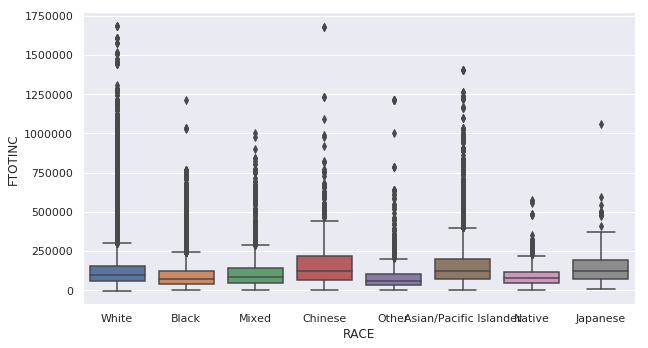

In [93]:
sns.catplot(x="RACE", y="FTOTINC", kind="box", data=data, aspect=22/12)

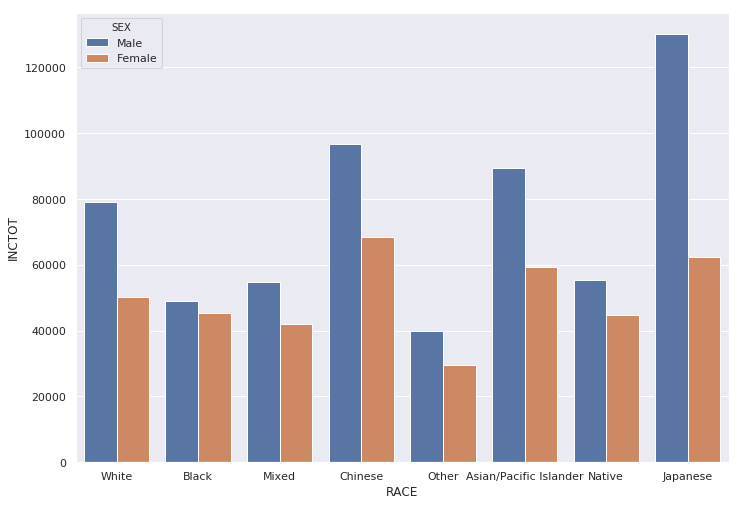

In [91]:
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.barplot(x="RACE", y="INCTOT", hue="SEX", data=data, ci=None)

Box plots and violin plots are good at showing variable (income) distribution for different groups. The boxplot above is comparing race to income. It shows that among the racial groups, Asians like Chinese and Japanese have the most differences in income within the 25-75 percentile. Then, with the bar graph, I looked at individual income to see differences between male and female pay. For all racial groups, men earn more than women. These are generalizations I found from this graph, but can not be entirely applied since it doesn't consider the household/person weight of the ACS sample. 